# Antisocial behaviour

Represented on multiple spatial scales: OA, LSOA, MSOA, square grid

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import h3pandas  # noqa (implicitly required)
import matplotlib.pyplot as plt
import osmnx as ox
import pandas as pd

from utils import (
    CATEGORIES,
    extract_crime_data,
    get_census_boundaries,
    get_force_boundary,
    get_geog_lookup,
    get_hex_grid,
    get_square_grid,
    lorenz_curve,
    snap_to_street_segment,
    tokenize_force_name,
)

In [3]:
FORCE = "West Yorkshire"

force_boundary = get_force_boundary(FORCE)
force_boundary

,PFA23CD,PFA23NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
9,E23000010,West Yorkshire,418683,427238,-1.71822,53.7412,d00fb092-09cf-4c1c-9a34-5ab2fd497455,"POLYGON ((407885.502 451894.696, 407943.597 45..."


In [15]:
all = extract_crime_data(tokenize_force_name(FORCE)).reset_index(drop=True)

asb = all[all["Crime type"] == CATEGORIES[1]]
asb

,Month,Reported by,Falls within,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context,geometry
12,2022-05,West Yorkshire Police,West Yorkshire Police,On or near Queen'S Gardens,E01010692,Bradford 001D,Anti-social behaviour,NaN,NaN,POINT (411354.013 447133.948)
13,2022-05,West Yorkshire Police,West Yorkshire Police,On or near Bus/Coach Station,E01010692,Bradford 001D,Anti-social behaviour,NaN,NaN,POINT (411854.969 447613.948)
14,2022-05,West Yorkshire Police,West Yorkshire Police,On or near Wells Road,E01010692,Bradford 001D,Anti-social behaviour,NaN,NaN,POINT (411758.03 447302.948)
15,2022-05,West Yorkshire Police,West Yorkshire Police,On or near Bus/Coach Station,E01010692,Bradford 001D,Anti-social behaviour,NaN,NaN,POINT (411854.969 447613.948)
20,2022-05,West Yorkshire Police,West Yorkshire Police,On or near Springs Lane,E01010691,Bradford 002A,Anti-social behaviour,NaN,NaN,POINT (412391.978 447481.039)
...,...,...,...,...,...,...,...,...,...,...
958403,2025-04,West Yorkshire Police,West Yorkshire Police,On or near John Street,E01011863,Wakefield 044D,Anti-social behaviour,NaN,NaN,POINT (446750.007 410878.044)
958404,2025-04,West Yorkshire Police,West Yorkshire Police,On or near Beech Street,E01011863,Wakefield 044D,Anti-social behaviour,NaN,NaN,POINT (446414.024 410431.008)
958405,2025-04,West Yorkshire Police,West Yorkshire Police,On or near Princess Avenue,E01011863,Wakefield 044D,Anti-social behaviour,NaN,NaN,POINT (446666.975 410800.005)
958433,2025-04,West Yorkshire Police,West Yorkshire Police,On or near Beamshaw,E01011866,Wakefield 045B,Anti-social behaviour,NaN,NaN,POINT (444840.023 410291.97)


In [16]:
# First group by LSOA (its already in the dataset)
asb_by_lsoa = asb.groupby("LSOA code")["Location"].count().rename("count")
asb_by_lsoa

LSOA code
E01005410     1
E01005414     1
E01005561     1
E01007319     1
E01007328     2
             ..
E01035050    32
E01035051    10
E01035052    13
E01035053    16
E01035054    33
Name: count, Length: 1450, dtype: int64

## Map crime intensity at LSOA level

In [28]:
# must account for LSOAs with no crimes (which means crimes outside force area are dropped)
lsoa_boundaries = get_census_boundaries("LSOA21", "GC").sjoin(force_boundary).join(asb_by_lsoa, how="left").fillna(0)
lsoa_boundaries.explore(
    "count",
    cmap="Reds",
    tiles="CartoDB positron",
    style_kwds=dict(color="black", weight=0.5, opacity=0.2, fillOpacity=0.7),
)

/tmp/ipykernel_23068/2012995010.py:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  lsoa_boundaries = get_census_boundaries("LSOA21", "GC").sjoin(force_boundary).join(asb_by_lsoa, how="left").fillna(0)


## Get mappings between other statistical geographies

Group crimes into these geographies

In [29]:
geog_lookup = get_geog_lookup("lsoa21cd", ["msoa21cd", "oa21cd"])
geog_lookup

,msoa21cd,oa21cd
lsoa21cd,,
S01013490,S02002516,S00137176
S01013856,S02002577,S00138891
S01013487,S02002515,S00137241
S01013482,S02002515,S00137245
S01013490,S02002516,S00137219
...,...,...
S01019745,S02003656,S00174719
S01019736,S02003654,S00174770
S01019720,S02003651,S00174881


In [30]:
asb_by_msoa = asb["LSOA code"].map(geog_lookup.msoa21cd.to_dict()).value_counts()
# TODO account for lost incidents (almost certainly 2011 LSOA codes)
sum(asb_by_lsoa), sum(asb_by_msoa)

(81805, 80784)

In [31]:
msoa_boundaries = get_census_boundaries("MSOA21", "GC").sjoin(force_boundary).join(asb_by_msoa, how="left").fillna(0)
msoa_boundaries.explore(
    "count",
    cmap="Reds",
    tiles="CartoDB positron",
    style_kwds=dict(color="black", weight=0.5, opacity=0.2, fillOpacity=0.7),
)

/tmp/ipykernel_23068/2903549037.py:1: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  msoa_boundaries = get_census_boundaries("MSOA21", "GC").sjoin(force_boundary).join(asb_by_msoa, how="left").fillna(0)


In [32]:
# do a spatial join to get ALL OAs in force area
oa_boundaries = get_census_boundaries("OA21", "GC").sjoin(force_boundary[["geometry"]]).drop(columns=["index_right"])
# get crime counts for OAs by right-joining boundaries to crime data (this wont include crime-free OAs)
asb_by_oa = oa_boundaries.sjoin(asb, how="right").groupby("OA21CD").LSOA21CD.count().rename("count")
# restore the crime-free OAs by left joining on the full set
oa_boundaries = oa_boundaries.join(asb_by_oa, how="left").fillna(0)
oa_boundaries.explore(
    "count",
    cmap="Reds",
    tiles="CartoDB positron",
    style_kwds=dict(color="black", weight=0.5, opacity=0.2, fillOpacity=0.7),
)

/tmp/ipykernel_23068/1063621976.py:6: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  oa_boundaries = oa_boundaries.join(asb_by_oa, how="left").fillna(0)


## Use grids

### Square grid

In [33]:
# overlay a 1k x 1k grid on force area
grid = get_square_grid(1000, FORCE)
# get crime counts for cells by right-joining boundaries to crime data (this wont include crime-free cells)
asb_by_sq = grid.sjoin(asb, how="right").groupby("index_left").PFA23CD.count().rename("count")
# restore the crime-free OAs by left joining on the full set
grid = grid.join(asb_by_sq, how="left").fillna(0)
grid.explore(
    "count",
    cmap="Reds",
    tiles="CartoDB positron",
    style_kwds=dict(color="black", weight=0.5, opacity=0.4, fillOpacity=0.7),
)

### Hexgrid

In [34]:
hexgrid = get_hex_grid(8, FORCE)
# get crime counts for cells by right-joining boundaries to crime data (this wont include crime-free cells)
asb_by_hex = hexgrid.sjoin(asb, how="right").groupby("h3_polyfill").h3_polyfill.count().rename("count")
# restore the crime-free OAs by left joining on the full set
hexgrid = hexgrid.join(asb_by_hex, how="left").fillna(0)
hexgrid.explore(
    "count",
    cmap="Reds",
    tiles="CartoDB positron",
    style_kwds=dict(color="black", weight=0.5, opacity=0.2, fillOpacity=0.7),
)

In [24]:
hexgrid.geometry[0].area

/home/az/dev/safer-streets/.venv/lib/python3.13/site-packages/geopandas/geoseries.py:720: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  val = getattr(super(), mtd)(*args, **kwargs)


654304.2710357824

# Street segments

In [25]:
# get street network in lon-lat polygon then project back to BNG
G = ox.graph_from_polygon(force_boundary.to_crs(epsg=4326).iloc[0].geometry, network_type="drive")
G = ox.project_graph(G, to_crs="epsg:27700")
_nodes, street_segments = ox.graph_to_gdfs(G)

In [26]:
asb_by_street = snap_to_street_segment(asb, street_segments)
# counts for each featured street segment
asb_by_street = asb_by_street.groupby(["street_segment"]).Location.count().rename("count")
asb_by_street.index = pd.MultiIndex.from_tuples(asb_by_street.index, names=["u", "v", "key"])
# left join onto all street segments and fill with zeros
asb_by_street = street_segments[["geometry"]].join(asb_by_street, how="left").fillna(0)
asb_by_street

/home/az/dev/safer-streets/.venv/lib/python3.13/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/az/dev/safer-streets/.venv/lib/python3.13/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


geometry  \
u           v           key                                                      
154919      2962968540  0    LINESTRING (431004.073 416510.865, 430972.006 ...   
2962968540  278811522   0    LINESTRING (430457.579 414793.349, 430414.78 4...   
            1589748998  0    LINESTRING (430457.579 414793.349, 430406.981 ...   
154941      10078678366 0    LINESTRING (429416.123 421372.84, 429499.781 4...   
            248959617   0    LINESTRING (429416.123 421372.84, 429471.844 4...   
...                                                                        ...   
12899865337 12899865328 0    LINESTRING (432372.623 422513.897, 432362.899 ...   
12899865335 12899865337 0    LINESTRING (432379.412 422517.493, 432372.623 ...   
12899865336 12899865337 0    LINESTRING (432377.988 422504.599, 432372.623 ...   
12899865343 12899865341 0    LINESTRING (432400.971 422446.333, 432396.17 4...   
12899865342 12899865341 0    LINESTRING (432392.051 422462.516, 432396.17 4...   

                             count  
u           v           key         
154919      2962968540  0      0.0  
2962968540  278811522   0      3.0  
            1589748998  0      1.0  
154941      10078678366 0      0.0  
            248959617   0      0.0  
...                            ...  
12899865337 12899865328 0      0.0  
12899865335 12899865337 0      0.0  
12899865336 12899865337 0      0.0  
12899865343 12899865341 0      0.0  
12899865342 12899865341 0      0.0  

[209623 rows x 2 columns]

In [ ]:
# map rendering crashes
# map = asb.explore("count")

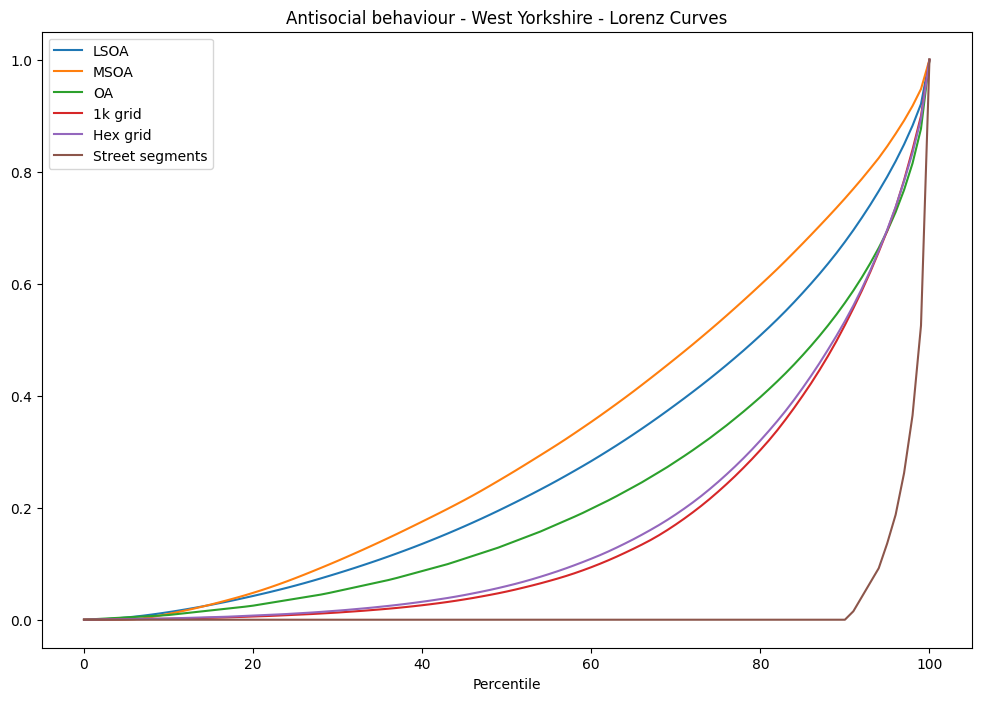

In [35]:
_, ax = plt.subplots(figsize=(12, 8))
lorenz_curve(asb_by_lsoa, percentiles=True).plot(title="LSOA", ax=ax, label="LSOA")
lorenz_curve(asb_by_msoa, percentiles=True).plot(title="LSOA", ax=ax, label="MSOA")
lorenz_curve(asb_by_oa, percentiles=True).plot(title="LSOA", ax=ax, label="OA")
lorenz_curve(asb_by_sq, percentiles=True).plot(title="LSOA", ax=ax, label="1k grid")
lorenz_curve(asb_by_hex, percentiles=True).plot(title="LSOA", ax=ax, label="Hex grid")
lorenz_curve(asb_by_street["count"], percentiles=True).plot(title="", ax=ax, label="Street segments")
ax.set_title(f"Antisocial behaviour - {FORCE} - Lorenz Curves")
ax.set_xlabel("Percentile")
ax.legend()